In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        # print(os.path.join(dirname, filename))
        pass

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
import pandas as pd
import numpy as np

from glob import glob
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt
from PIL import Image

plt.style.use('ggplot')

In [3]:
annot = pd.read_parquet('../input/textocr-text-extraction-from-images-dataset/annot.parquet')
imgs = pd.read_parquet('../input/textocr-text-extraction-from-images-dataset/img.parquet')
img_fns = glob('../input/textocr-text-extraction-from-images-dataset/train_val_images/train_images/*')

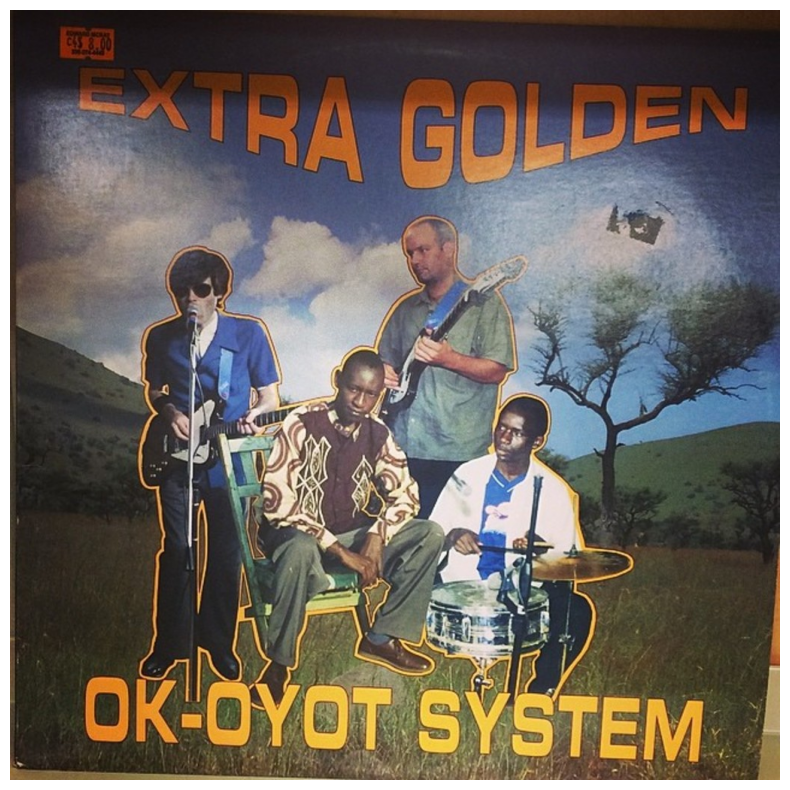

In [4]:
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(plt.imread(img_fns[0]))
ax.axis('off')
plt.show()

In [5]:
image_id = img_fns[0].split('/')[-1].split('.')[0]
annot.query('image_id == @image_id')

,id,image_id,bbox,utf8_string,points,area
674889,f644219f560e3778_1,f644219f560e3778,"[64.54, 22.34, 75.25, 47.22]",.,"[67.49, 22.34, 139.79, 28.25, 139.79, 69.56, 6...",3553.30
674890,f644219f560e3778_2,f644219f560e3778,"[68.97, 62.18, 419.03, 191.81]",EXTRA,"[77.82, 62.18, 488.0, 71.03, 483.57, 253.99, 6...",80374.14
674891,f644219f560e3778_3,f644219f560e3778,"[510.13, 81.36, 486.9, 180.01]",GOLDEN,"[511.6, 81.36, 995.55, 82.84, 997.03, 242.19, ...",87646.87
674892,f644219f560e3778_4,f644219f560e3778,"[89.63, 876.63, 432.3, 118.03]",OK-OYOT,"[91.1, 876.63, 521.93, 889.91, 521.93, 994.66,...",51024.37
674893,f644219f560e3778_5,f644219f560e3778,"[532.26, 892.86, 402.8, 118.03]",SYSTEM,"[532.26, 892.86, 935.06, 910.56, 930.63, 1010....",47542.48


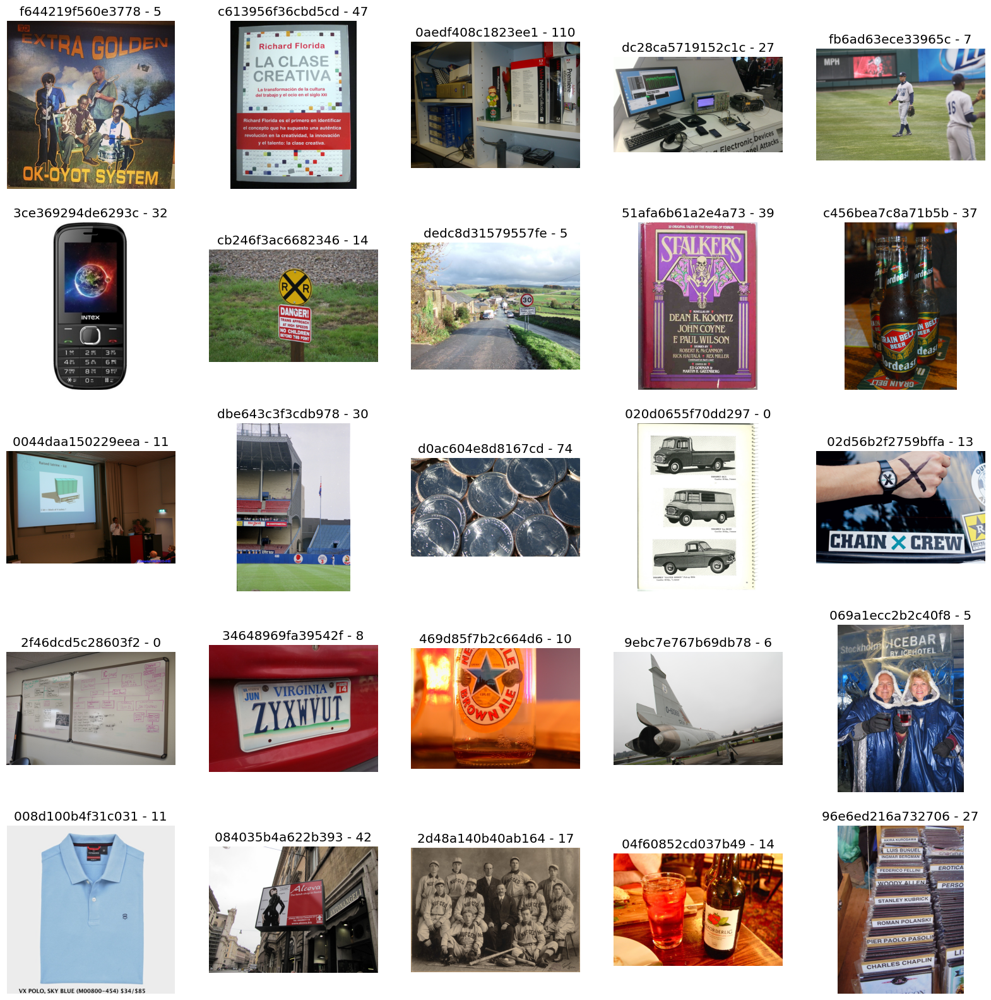

In [6]:
fig, axs = plt.subplots(5, 5, figsize=(20, 20))
axs = axs.flatten()
for i in range(25):
    axs[i].imshow(plt.imread(img_fns[i]))
    axs[i].axis('off')
    image_id = img_fns[i].split('/')[-1].rstrip('.jpg')
    n_annot = len(annot.query('image_id == @image_id'))
    axs[i].set_title(f'{image_id} - {n_annot}')
plt.show()

## Pytesseract

This works good with documents, but does not give good results with image

In [7]:
import pytesseract

# Example call
print(pytesseract.image_to_string(img_fns[11], lang='eng'))

   

Shichi
ae : oe



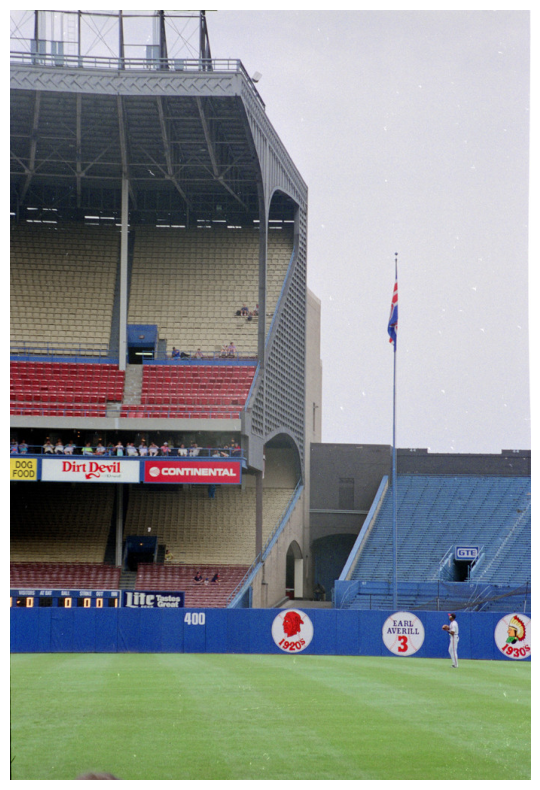

In [8]:
fig, ax = plt.subplots(figsize=(10,10))
ax.imshow(plt.imread(img_fns[11]))
ax.axis('off')
plt.show()

## Easy OCR

In [9]:
import easyocr

reader = easyocr.Reader(['en'], gpu = True)

In [10]:
results = reader.readtext(img_fns[11])

In [11]:
pd.DataFrame(results, columns=['bbox','text','conf'])

,bbox,text,conf
0,"[[2, 598], [36, 598], [36, 626], [2, 626]]",D,0.134166
1,"[[65, 595], [150, 595], [150, 627], [65, 627]]",Dirtpevil,0.694569
2,"[[201, 607], [303, 607], [303, 623], [201, 623]]",CONIINENTAL,0.425330
3,"[[150, 772], [230, 772], [230, 798], [150, 798]]",Wcti,0.035467
4,"[[228, 798], [262, 798], [262, 822], [228, 822]]",400,0.999467
5,"[[507, 811], [539, 811], [539, 823], [507, 823]]",EARL,0.993677
6,"[[499, 819], [547, 819], [547, 833], [499, 833]]",AVERILL,0.998111
7,"[[361, 839], [389, 839], [389, 853], [361, 853]]",920,0.999383
8,"[[656, 844], [692, 844], [692, 864], [656, 864]]",9305,0.395831


In [12]:
!pip install --force-reinstall -q "tensorflow==2.15.1"

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
apache-beam 2.46.0 requires cloudpickle~=2.2.1, but you have cloudpickle 3.0.0 which is incompatible.
apache-beam 2.46.0 requires dill<0.3.2,>=0.3.1.1, but you have dill 0.3.8 which is incompatible.
apache-beam 2.46.0 requires numpy<1.25.0,>=1.14.3, but you have numpy 1.26.4 which is incompatible.
apache-beam 2.46.0 requires protobuf<4,>3.12.2, but you have protobuf 4.25.5 which is incompatible.
apache-beam 2.46.0 requires pyarrow<10.0.0,>=3.0.0, but you have pyarrow 17.0.0 which is incompatible.
beatrix-jupyterlab 2024.66.154055 requires jupyterlab~=3.6.0, but you have jupyterlab 4.2.5 which is incompatible.
bigframes 0.22.0 requires google-cloud-bigquery[bqstorage,pandas]>=3.10.0, but you have google-cloud-bigquery 2.34.4 which is incompatible.
bigframes 0.22.0 requires google-cloud-storage>=2.0.0, but you have 

In [13]:
!pip install -q git+https://github.com/faustomorales/keras-ocr.git#egg=keras-ocr

## Keras OCR

In [14]:
import matplotlib.pyplot as plt

import keras_ocr
 
# keras-ocr will automatically download pretrained
# weights for the detector and recognizer.
pipeline = keras_ocr.pipeline.Pipeline()

2024-11-13 02:26:14.983381: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-13 02:26:14.983460: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-13 02:26:14.985191: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Looking for /root/.keras-ocr/craft_mlt_25k.h5
Looking for /root/.keras-ocr/crnn_kurapan.h5


In [15]:
import keras_ocr

# Create a pipeline for OCR
pipeline = keras_ocr.pipeline.Pipeline()

Looking for /root/.keras-ocr/craft_mlt_25k.h5
Looking for /root/.keras-ocr/crnn_kurapan.h5


In [16]:
results = pipeline.recognize([img_fns[11]])

1/1 [==============================] - 4s 4s/step


In [17]:
pd.DataFrame(results[0], columns=['text', 'bbox'])

,text,bbox
0,dog,"[[6.0, 599.0], [31.0, 599.0], [31.0, 610.0], [..."
1,dirt,"[[67.53808, 597.46704], [104.066, 600.0762], [..."
2,devil,"[[101.0, 600.0], [149.0, 600.0], [149.0, 622.0..."
3,continental,"[[200.06012, 606.7333], [302.16663, 608.1714],..."
4,food,"[[2.0, 611.0], [34.0, 611.0], [34.0, 623.0], [..."
5,gte,"[[595.0, 718.0], [619.0, 718.0], [619.0, 726.0..."
6,litersts,"[[152.32657, 772.63214], [228.6387, 776.5456],..."
7,400,"[[230.0, 800.0], [261.0, 800.0], [261.0, 819.0..."
8,earl,"[[507.10864, 809.71954], [536.4231, 811.1154],..."
9,averill,"[[500.0, 821.0], [545.0, 821.0], [545.0, 831.0..."


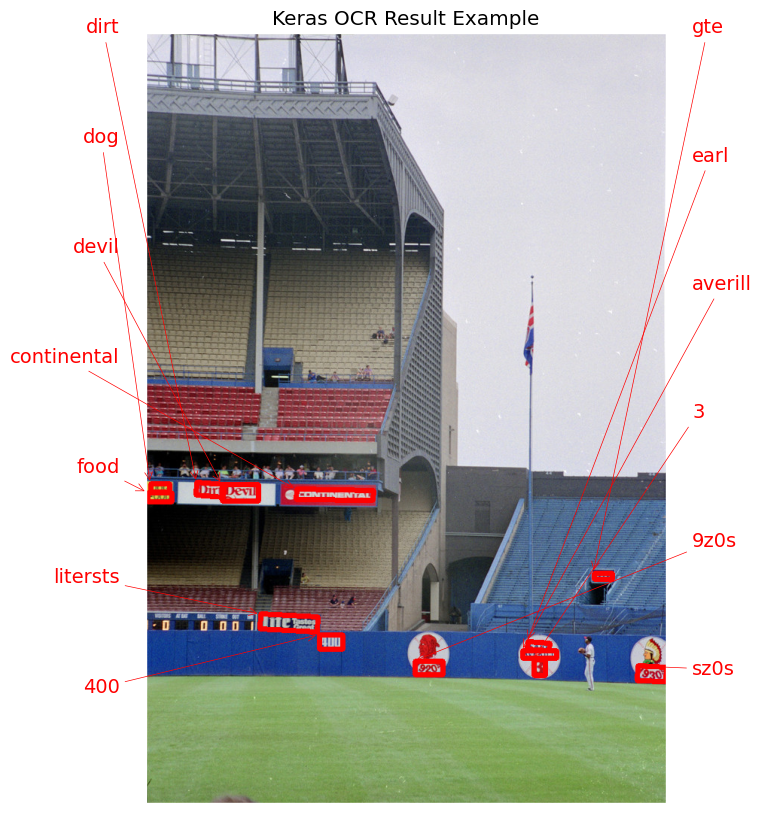

In [18]:
fig, ax = plt.subplots(figsize=(10, 10))
keras_ocr.tools.drawAnnotations(plt.imread(img_fns[11]), results[0], ax=ax)
ax.set_title('Keras OCR Result Example')
plt.show()

In [21]:
# easyocr
reader = easyocr.Reader(['en'], gpu = True)

dfs = []
for img in tqdm(img_fns[:25]):
    result = reader.readtext(img)
    img_id = img.split('/')[-1].split('.')[0]
    img_df = pd.DataFrame(result, columns=['bbox','text','conf'])
    img_df['img_id'] = img_id
    dfs.append(img_df)
easyocr_df = pd.concat(dfs)

  0%|          | 0/25 [00:00<?, ?it/s]

In [22]:
# keras_ocr
pipeline = keras_ocr.pipeline.Pipeline()

dfs = []
for img in tqdm(img_fns[:25]):
    results = pipeline.recognize([img])
    result = results[0]
    img_id = img.split('/')[-1].split('.')[0]
    img_df = pd.DataFrame(result, columns=['text', 'bbox'])
    img_df['img_id'] = img_id
    dfs.append(img_df)
kerasocr_df = pd.concat(dfs)

Looking for /root/.keras-ocr/craft_mlt_25k.h5
Looking for /root/.keras-ocr/crnn_kurapan.h5


  0%|          | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 3s 3s/step


## Comparisions

In [23]:
def plot_compare(img_fn, easyocr_df, kerasocr_df):
    img_id = img_fn.split('/')[-1].split('.')[0]
    fig, axs = plt.subplots(1, 2, figsize=(15, 10))

    easy_results = easyocr_df.query('img_id == @img_id')[['text','bbox']].values.tolist()
    easy_results = [(x[0], np.array(x[1])) for x in easy_results]
    keras_ocr.tools.drawAnnotations(plt.imread(img_fn), 
                                    easy_results, ax=axs[0])
    axs[0].set_title('easyocr results', fontsize=24)

    keras_results = kerasocr_df.query('img_id == @img_id')[['text','bbox']].values.tolist()
    keras_results = [(x[0], np.array(x[1])) for x in keras_results]
    keras_ocr.tools.drawAnnotations(plt.imread(img_fn), 
                                    keras_results, ax=axs[1])
    axs[1].set_title('keras_ocr results', fontsize=24)
    plt.show()

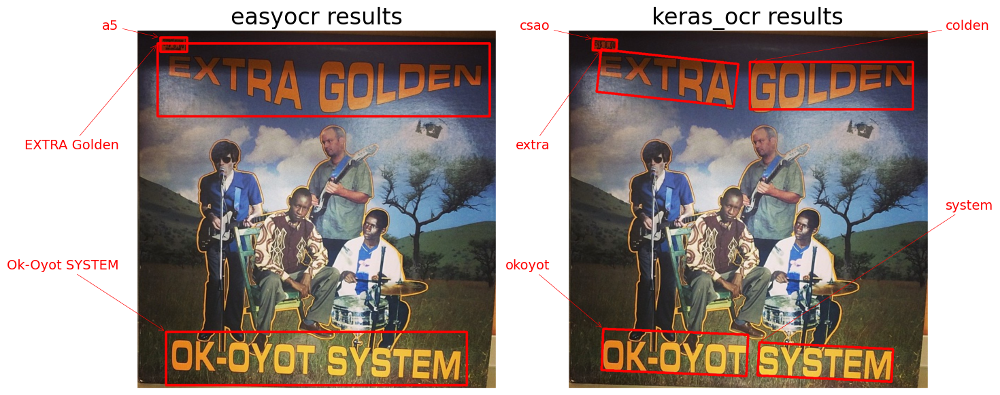

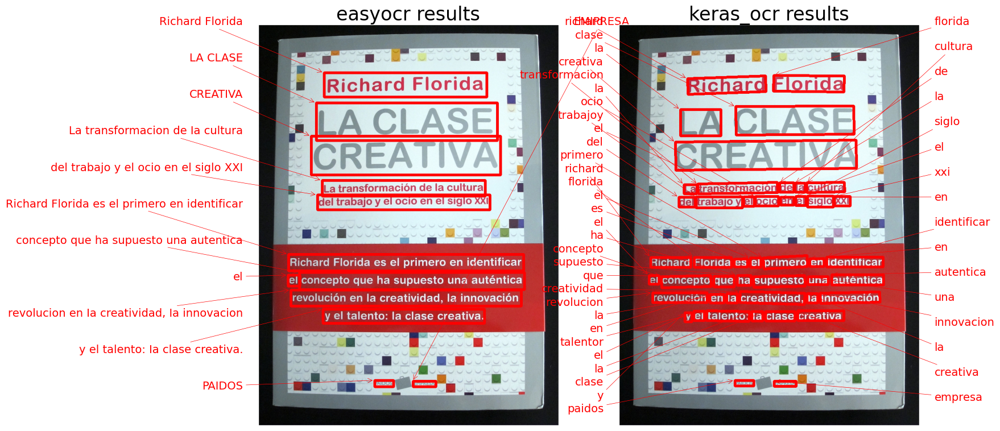

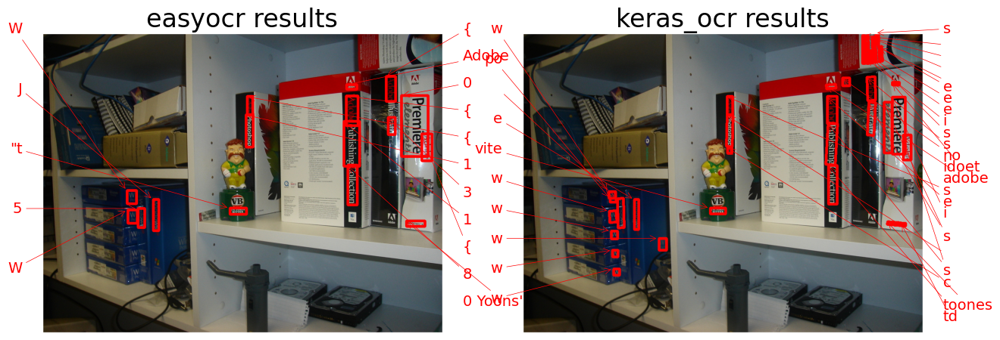

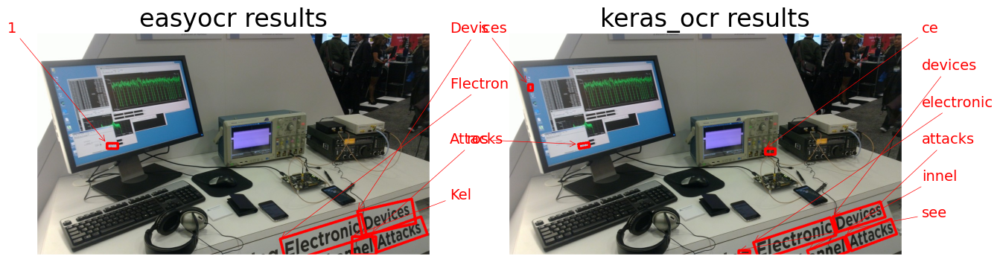

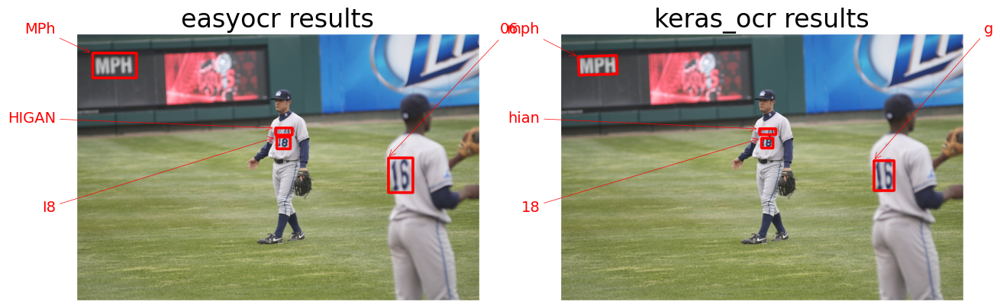

...

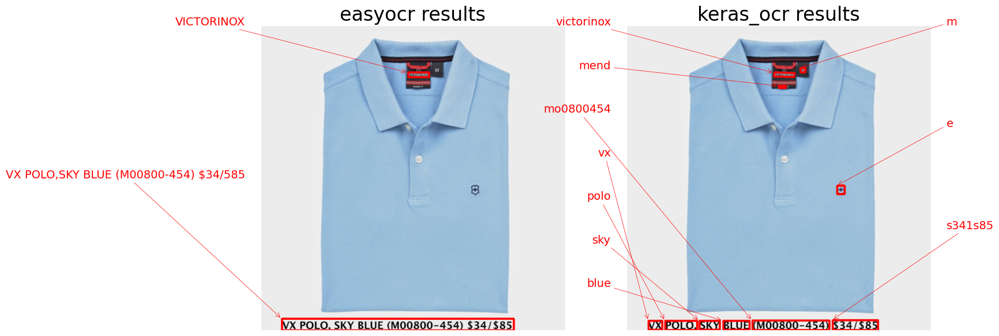

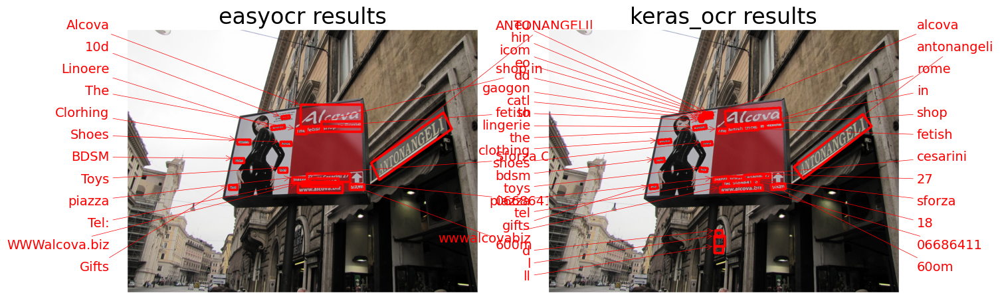

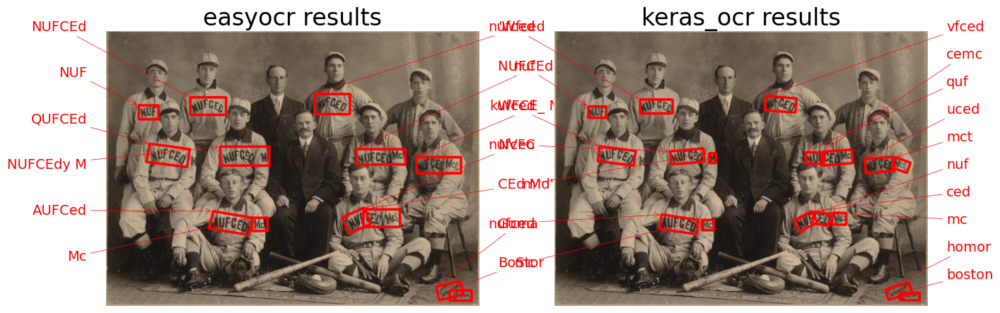

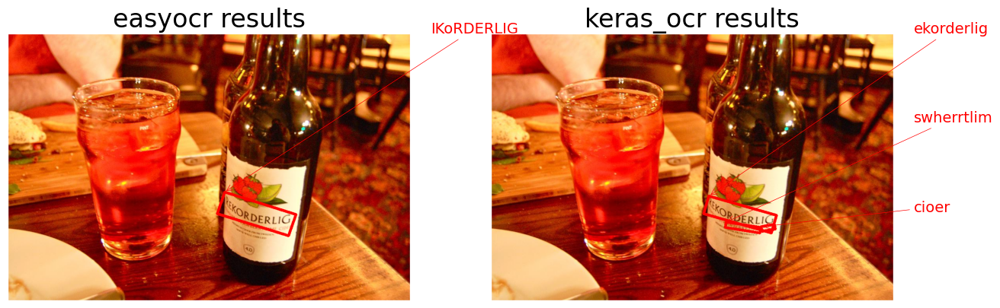

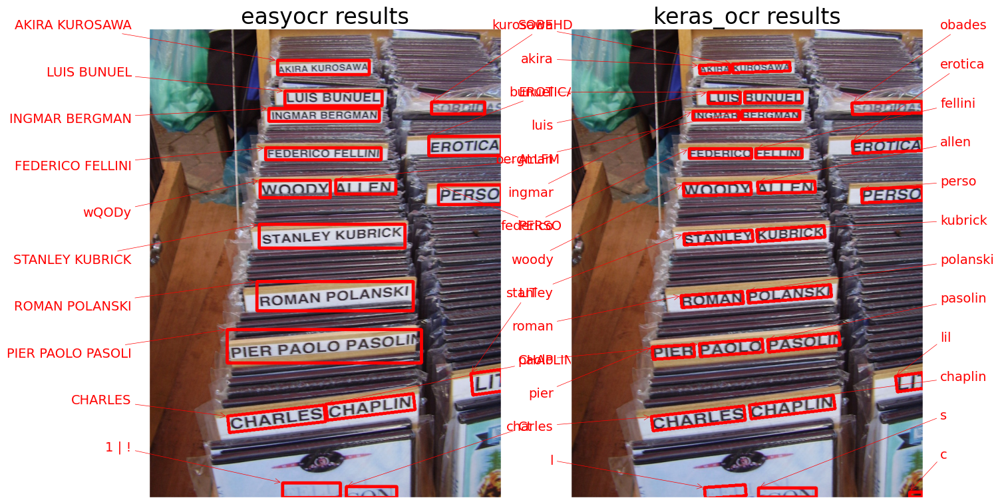

In [24]:
# Loop over results
for img_fn in img_fns[:25]:
    plot_compare(img_fn, easyocr_df, kerasocr_df)